# 'Tis the season (for fractals) #
#### Ann Arbor Scientific and Technical Computing, January 28th 2021
#### Presented by David Perner
<img src="img/44508_900.png" style="width:800px"></img>

## So what are fractals? ##

The main defining feature of fractals is self-similarity. That is, if you pick a part of a fractal and zoom in, evetually you will find features that resemble the original, unzoomed fractal.

Beyond the math that describes them, such patterns are quite common in the natural world. Some of the more common examples include:
<div class="row" style="display:flex">
    <div class="column" style="width:50%">
        <img src="img/fractal_fern.jpg" align="top" style="height:200px"></img>
        <h3 style="text-align:center">Fern leaves</h3>
    </div>
    <div class="column" style="width:50%">
        <img src="img/fractal_broccoli.jpg" align="top" style="height:200px"></img>
        <h3 style="text-align:center">Romenesco brocolli</h3>
    </div>
</div>
<br clear="top"></br>
<div class="row" style="display:flex">
    <div class="column" style="width:50%">
        <img src="img/ice_fractal.jpg" align="top" style="height:200px"></img>
        <h3 style="text-align:center">Ice crystals</h3>
    </div>
        <div class="column" style="width:50%">
        <img src="img/bismuth_fractal.png" align="top" style="height:200px"></img>
        <h3 style="text-align:center">Bismuth crystrals</h3>
    </div>
</div>

## So what's a Julia set? ##

This is a bit more complicated. There are a few explanations, but the one that makes the most "plain English" sense (to me at least) is that a Julia set shows where functions are highly sensative. That is, where small changes in their inputs produce very different outputs. The set is then the number of solutions that exist around a certain point. It's also worth noting that Julia sets describe complex functions, so functions with values that have both real and imaginary components.

<img src="img/1920px-RiemannKugel.svg.png" width="400px"></img>

In our case though, we're capping the number of solutions to 10,000, since they can go on forever in theory and we have limited time to do our computations.

As a bit of a side note, they are related to Fatou sets, which are more a measure of stability than instability. Also, as much as I love the Julia programming language, the set is named after French mathematician Gaston Julia, and the programming language, according to its creators, wasn't named after anyone in particular. 

In [1]:
using Plots, Interact

┌ Info: Precompiling Plots [91a5bcdd-55d7-5caf-9e0b-520d859cae80]
└ @ Base loading.jl:1278
┌ Info: Precompiling Interact [c601a237-2ae4-5e1e-952c-7a85b0c7eef1]
└ @ Base loading.jl:1278


HTML{String}("<script>\n// Immediately-invoked-function-expression to avoid global variables.\n(function() {\n    var warning_div = document.getElementById(\"webio-warning-2780608155084422386\");\n    var hide = function () {\n        var script = document.getElementById(\"webio-setup-17555071612104740425\");\n        var parent = script && script.parentElement;\n        var grandparent = parent && parent.parentElement;\n        if (grandparent) {\n            grandparent.style.display = \"none\";\n        }\n        warning_div.style.display = \"none\";\n    };\n    if (typeof Jupyter !== \"undefined\") {\n        console.log(\"WebIO detected Jupyter notebook environment.\");\n        // Jupyter notebook.\n        var extensions = (\n            Jupyter\n            && Jupyter.notebook.config.data\n            && Jupyter.notebook.config.data.load_extensions\n        );\n        if (extensions && extensions[\"webio-jupyter-notebook\"]) {\n            // Extension already loaded.\n            console.log(\"Jupyter WebIO nbextension detected; not loading ad-hoc.\");\n            hide();\n            return;\n        }\n    } else if (window.location.pathname.includes(\"/lab\")) {\n        // Guessing JupyterLa\n        console.log(\"Jupyter Lab detected; make sure the @webio/jupyter-lab-provider labextension is installed.\");\n        hide();\n        return;\n    }\n})();\n\n</script>\n<p\n    id=\"webio-warning-2780608155084422386\"\n    class=\"output_text output_stderr\"\n    style=\"padding: 1em; font-weight: bold;\"\n>\n    Unable to load WebIO. Please make sure WebIO works for your Jupyter client.\n    For troubleshooting, please see <a href=\"https://juliagizmos.github.io/WebIO.jl/latest/providers/ijulia/\">\n    the WebIO/IJulia documentation</a>.\n    <!-- TODO: link to installation docs. -->\n</p>\n")

Using the [pseudocode](https://en.wikipedia.org/wiki/Julia_set#Pseudocode) from Wikipedia, we can create a closure that produces specific instances of the normal Julia set function. R is the "escape radius", or a measure of the sensitivity we're interested in, and c is a complex number that represents where in the complex plane we're operating.

In [2]:
function jset_gen(R, c, xlim, ylim)
    function jset_act(x,y)
        zx = 2R*((x-xlim[1])/(xlim[2]-xlim[1]))-R
        zy = 2R*((y-ylim[1])/(ylim[2]-ylim[1]))-R
        iter_num = 0
        max_iter = 10_000
        xtemp = 0
        while zx^2 + zy^2 < R^2 && iter_num<max_iter
            xtemp = zx^2 - zy^2
            zy = 2*zx*zy + imag(c)
            zx = xtemp + real(c)

            iter_num+=1
        end

        iter_num == max_iter ? 0 : sqrt(iter_num) #return value square-rooted for plotting quality purposes
    end
end

jset_gen (generic function with 1 method)

In [3]:
jset1 = jset_gen(2, complex(-0.7269, 0.1889), [-1;1], [-1;1]);

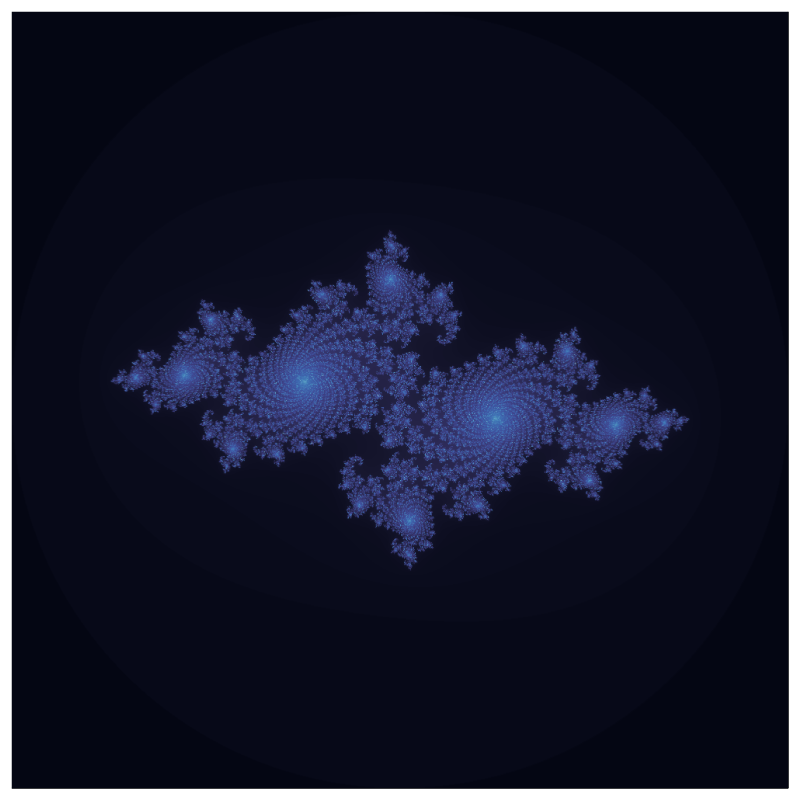

In [4]:
xrange = range(-1,1,length=1000)
yrange = range(-1,1,length=1000)
plot(
    xrange,
    yrange, 
    jset1, 
    st=:surface, 
    camera=(0, 90), 
    legend=:none, 
    xlim = [-1;1], 
    ylim=[-1;1], 
    aspect_ratio=1,
    c = :ice,
    axis=nothing,
    size= (800,800))

┌ Info: Saved animation to 
│   fn = /Users/crashburnrepeat/AASTC/January 2021/img/jset1.gif
└ @ Plots /Users/crashburnrepeat/.julia/packages/Plots/SVksJ/src/animation.jl:104


Plots.AnimatedGif("/Users/crashburnrepeat/AASTC/January 2021/img/jset1.gif")
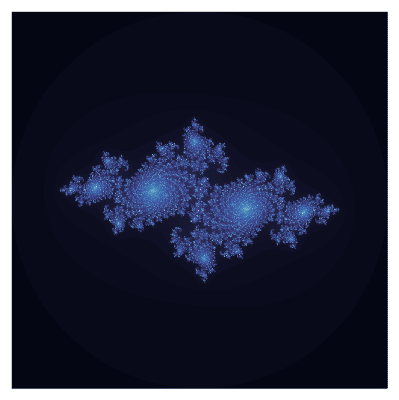

In [5]:
anim = @animate for i in range(0, length=300)
    scale = 10^(-i/50)
    xrange = range(-scale,scale,length=500)
    yrange = range(-scale,scale,length=500)
    plot(
        xrange,
        yrange, 
        jset1, 
        st=:surface, 
        camera=(0, 90), 
        legend=:none, 
        xlim = [-scale;scale], 
        ylim=[-scale;scale], 
        aspect_ratio=1,
        c = :ice,
        axis=nothing,
        size= (400,400))
end

gif(anim, "img/jset1.gif", fps=15)

In [6]:
@manipulate for c_real=-1:0.01:1, c_imag=-1:0.01:1
    slide_jset = jset_gen(2, complex(c_real, c_imag), [-1;1], [-1;1])
    xrange = range(-1,1,length=500)
    yrange = range(-1,1,length=500)
    plot(
        xrange,
        yrange, 
        slide_jset, 
        st=:surface, 
        camera=(0, 90), 
        legend=:none, 
        xlim = [-1;1], 
        ylim=[-1;1], 
        aspect_ratio=1,
        c = :ice,
        axis=nothing,
        size= (400,400)
        )
end

Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :label), Any["c_real"], Dict{Symbol,Any}(:className => "interact ",:style => Dict{Any,Any}(:padding => "5px 10px 0px 10px")))], Dict{Symbol,Any}(:className => "interact-flex-row-left")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :input), Any[], Dict{Symbol,Any}(:max => 201,:min => 1,:attributes => Dict{Any,Any}(:type => "range",Symbol("data-bind") => "numericValue: index, valueUpdate: 'input', event: {change: function (){this.changes(this.changes()+1)}}","orient" => "horizontal"),:step => 1,:className => "slider slider is-fullwidth",:style => Dict{Any,Any}()))], Dict{Symbol,Any}(:className => "interact-flex-row-center")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes => Dict("data-bind" => "text: formatted_val")))], Dict{Symbol,Any}(:className => "interact-flex-row-right"))], Dict{Symbol,Any}(:className => "interact-flex-row interact-widget")), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes" => (Observable{Int64} with 1 listeners. Value:
0, nothing),"index" => (Observable{Any} with 2 listeners. Value:
101, nothing)), Set{String}(), nothing, Asset[Asset("js", "knockout", "/Users/crashburnrepeat/.julia/packages/Knockout/IP1uR/src/../assets/knockout.js"), Asset("js", "knockout_punches", "/Users/crashburnrepeat/.julia/packages/Knockout/IP1uR/src/../assets/knockout_punches.js"), Asset("js", nothing, "/Users/crashburnrepeat/.julia/packages/InteractBase/Zfu5P/src/../assets/all.js"), Asset("css", nothing, "/Users/crashburnrepeat/.julia/packages/InteractBase/Zfu5P/src/../assets/style.css"), Asset("css", nothing, "/Users/crashburnrepeat/.julia/packages/Interact/SbgIk/src/../assets/bulma_confined.min.css")], Dict{Any,Any}("changes" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"changes\"]()) ? (this.valueFromJulia[\"changes\"]=true, this.model[\"changes\"](val)) : undefined})")],"index" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"index\"]()) ? (this.valueFromJulia[\"index\"]=true, this.model[\"index\"](val)) : undefined})")]), WebIO.ConnectionPool(Channel{Any}(sz_max:32,sz_curr:0), Set{AbstractConnection}(), Base.GenericCondition{Base.AlwaysLockedST}(Base.InvasiveLinkedList{Task}(Task (runnable) @0x000000012856c010, Task (runnable) @0x000000012856c010), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = (function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init: function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            });\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            });\n            ko.applyBindingsToNode(\n                element,\n                {\n                    value: stringified,\n                    valueUpdate: allBindings.get('valueUpdate'),\n                },\n                context,\n            );\n        }\n    };\n    var json_data = {\"formatted_vals\":[\"-1.0\",\"-0.99\",\"-0.98\",\"-0.97\",\"-0.96\",\"-0.95\",\"-0.94\",\"-0.93\",\"-0.92\",\"-0.91\",\"-0.9\",\"-0.89\",\"-0.88\",\"-0.87\",\"-0.86\",\"-0.85\",\"-0.84\",\"-0.83\",\"-0.82\",\"-0.

## So where do these come up? ##

So we talked a bit about where fractals occur in nature, but there are a number of human applications.

### Art ###
Probably the most famous example of creative, fractal, human-produced art is that of Jackson Pollock. M.C. Escher, certain types of African art, and even novels have been shown to have (or were constructed to follow) fractal patterns.
<img src="img/pollock.jpg" width="400px"></img>

### Technology ###
- Fractal Antennas
- Fracture Mechanics
- Signal and image compression
- Procedurally generated landscapes
<img src="img/6452553_Vicsek_Fractal_Antenna.png" width="400px"></img>